## Housing cost forecasting

In a project, we need to train a linear regression model on California housing data in 1990. Based on the data, we need to predict the median value of a house in a residential area. We will train the model and make predictions on the test set. To assess the quality of the model, we use the RMSE, MAE and R2 metrics.

### Description of data

The dataset columns contain the following data:
- **longitude** - latitude
- **latitude** - longitude
- **housing_median_age** - median age of residents of the residential area
- **total_rooms** - the total number of rooms in the houses of the residential area
- **total_bedrooms** - the total number of bedrooms in the houses of the residential area
- **population** - the number of people who live in the residential area
- **households** - the number of households in the residential area
- **median_income** - median income of residents of the residential area
- **median_house_value** - median cost of a house in a residential area
- **ocean_proximity** - proximity to the ocean

Based on the data, we need to predict the median cost of a house in a residential area - `median_house_value`

We import everything that may be needed to complete the project:

In [1]:
import pandas as pd 
import numpy as np

import pyspark
from pyspark.sql import SparkSession
from pyspark.sql.types import *
import pyspark.sql.functions as F
from pyspark.ml import Pipeline

import folium
from folium.plugins import MarkerCluster

from pyspark.ml.feature import StringIndexer, Imputer, VectorAssembler, StandardScaler
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

pyspark_version = pyspark.__version__
if int(pyspark_version[:1]) == 3:
    from pyspark.ml.feature import OneHotEncodeEstimator    
elif int(pyspark_version[:1]) == 2:
    from pyspark.ml.feature import OneHotEncoder
        
RANDOM_SEED = 12345

spark = (SparkSession.builder 
                    .master("local") 
                    .appName("test_app") 
                    .getOrCreate())

PTH = '/datasets/housing.csv'
PTH_CL = '/datasets/clusters.csv'

# Data preparation

### Data at a Glance

In [2]:
df_housing = spark.read.csv(PTH, inferSchema = True, header = True)
df_housing.printSchema() 

root
 |-- longitude: double (nullable = true)
 |-- latitude: double (nullable = true)
 |-- housing_median_age: double (nullable = true)
 |-- total_rooms: double (nullable = true)
 |-- total_bedrooms: double (nullable = true)
 |-- population: double (nullable = true)
 |-- households: double (nullable = true)
 |-- median_income: double (nullable = true)
 |-- median_house_value: double (nullable = true)
 |-- ocean_proximity: string (nullable = true)



Only one `string` variable is **`ocean_proximity`**, all other columns are `double`

In [3]:
df_housing.describe().toPandas().set_index('summary').T

summary,count,mean,stddev,min,max
longitude,20640,-119.56970445736148,2.003531723502584,-124.35,-114.31
latitude,20640,35.6318614341087,2.135952397457101,32.54,41.95
housing_median_age,20640,28.639486434108527,12.58555761211163,1.0,52.0
total_rooms,20640,2635.7630813953488,2181.6152515827944,2.0,39320.0
total_bedrooms,20433,537.8705525375618,421.38507007403115,1.0,6445.0
population,20640,1425.4767441860465,1132.46212176534,3.0,35682.0
households,20640,499.5396802325581,382.3297528316098,1.0,6082.0
median_income,20640,3.8706710029070246,1.899821717945263,0.4999,15.0001
median_house_value,20640,206855.81690891474,115395.61587441359,14999.0,500001.0
ocean_proximity,20640,None,None,<1H OCEAN,NEAR OCEAN


Visually no problem - quantitative signs by number of rooms or population > 0

Let's check the data array for .

In [4]:
%%time
columns = df_housing.columns

for column in columns:
    condition = df_housing.where(F.isnan(column) | F.col(column).isNull()).count()
    if condition > 0:
        print(column ,condition)

total_bedrooms 207
CPU times: user 21.4 ms, sys: 4.99 ms, total: 26.4 ms
Wall time: 4.86 s


In [5]:
map_pp = folium.Map(location=[34.3,-118.14], zoom_start = 8)

In [6]:
lat = df_housing.toPandas()['latitude']
lon = df_housing.toPandas()['longitude']
prc = (df_housing.withColumn('median_house_value_k', 
                             F.round(F.col('median_house_value')/1000, 1))
                 .toPandas()['median_house_value_k'])

In [7]:
marker_cluster = MarkerCluster().add_to(map_pp)

In [8]:
for lat, lon, prc in zip(lat, lon, prc):
    folium.Marker(location=[lat, lon], radius = 9, 
                  popup=str(prc)+" kUSD",
                  color="gray", fill_opacity = 0.9).add_to(marker_cluster)

In [9]:
map_pp

### Data preprocessing

Let's divide the columns into two types: numeric and text, which represent categorical data:

In [10]:
categorical_cols  = 'ocean_proximity'
target = 'median_house_value' 
numerical_cols = [x for x in df_housing.columns if x not in [categorical_cols, target]]

**Split into train and test**  
We divide our dataset into two parts - a sample for training and a sample for testing the quality of the model.

In [11]:
train_data, test_data = df_housing.randomSplit([.8,.2], seed=RANDOM_SEED)
print(train_data.count(), test_data.count()) 

16463 4177


**Now we need to solve two problems:**
   - replace omissons
   - do OHE for a categorical feature

**Working with omissons**

For the first item, let's use the built-in **`imputer`** estimator.  
The replacement strategy is to replace with medians.

In [12]:
imputer = Imputer(
    inputCols  = numerical_cols, 
    outputCols = numerical_cols
    ).setStrategy("median")

imptr = imputer.fit(train_data)

train_data = imptr.transform(train_data)
test_data = imptr.transform(test_data)

**Check**

In [13]:
%%time
columns = train_data.columns

for column in columns:
    condition = train_data.where(F.isnan(column) | F.col(column).isNull()).count()
    if condition > 0:
        print(column, condition)

CPU times: user 13.1 ms, sys: 6.46 ms, total: 19.5 ms
Wall time: 5.44 s


In [14]:
%%time
columns = test_data.columns

for column in columns:
    condition = test_data.where(F.isnan(column) | F.col(column).isNull()).count()
    if condition > 0:
        print(column, condition)

CPU times: user 17.2 ms, sys: 2.47 ms, total: 19.7 ms
Wall time: 3.83 s


**OHE for a categorical feature**

First of all, we transform categorical features using the `StringIndexer` estimator.  
It translates text categories into numerical representation,

In [15]:
%%time
indexer = StringIndexer(inputCol = 'ocean_proximity', 
                        outputCol = 'ocean_proximity_idx') 

CPU times: user 2.83 ms, sys: 1.09 ms, total: 3.92 ms
Wall time: 13.5 ms


In [16]:
idx = indexer.fit(train_data)

train_data = idx.transform(train_data)
test_data = idx.transform(test_data)

cols = [c for c in train_data.columns for i in [categorical_cols] if (c.startswith(i))]
train_data.select(cols).show(3) 

+---------------+-------------------+
|ocean_proximity|ocean_proximity_idx|
+---------------+-------------------+
|     NEAR OCEAN|                2.0|
|     NEAR OCEAN|                2.0|
|     NEAR OCEAN|                2.0|
+---------------+-------------------+
only showing top 3 rows



Now the encoding:

In [17]:
%%time
encoder = OneHotEncoder(inputCol = 'ocean_proximity_idx',
                        outputCol = 'ocean_proximity_ohe')

train_data = encoder.transform(train_data)
test_data = encoder.transform(test_data)

CPU times: user 6.97 ms, sys: 2.22 ms, total: 9.19 ms
Wall time: 87.8 ms


In [18]:
cols = [c for c in train_data.columns for i in [categorical_cols] if (c.startswith(i))]
train_data.select(cols).show(3) 

+---------------+-------------------+-------------------+
|ocean_proximity|ocean_proximity_idx|ocean_proximity_ohe|
+---------------+-------------------+-------------------+
|     NEAR OCEAN|                2.0|      (4,[2],[1.0])|
|     NEAR OCEAN|                2.0|      (4,[2],[1.0])|
|     NEAR OCEAN|                2.0|      (4,[2],[1.0])|
+---------------+-------------------+-------------------+
only showing top 3 rows



The final step of the transformations is the combination of features into one vector, with which the ML algorithm can work.

In [19]:
categorical_assembler = \
        VectorAssembler(inputCols = ['ocean_proximity_ohe'],
                                        outputCol="categorical_features")
train_data = categorical_assembler.transform(train_data) 
test_data = categorical_assembler.transform(test_data) 

**Additional transformations**

For numerical features, a transformation is also needed - scaling of values - so that strong outliers do not shift the predictions of the model.  
According to the condition, we will train regression => we need to scale.

In [20]:
numerical_assembler = VectorAssembler(inputCols = numerical_cols, outputCol="numerical_features")

train_data = numerical_assembler.transform(train_data)
test_data = numerical_assembler.transform(test_data)

In [21]:
standardScaler = StandardScaler(inputCol='numerical_features', outputCol="numerical_features_scaled")

sclr = standardScaler.fit(train_data)

train_data = sclr.transform(train_data)
test_data = sclr.transform(test_data)

**The final step is to assemble the transformed categorical and numerical features using VectorAssembler.**

In [22]:
%%time
all_features = ['categorical_features','numerical_features_scaled']

final_assembler = VectorAssembler(inputCols=all_features, 
                                  outputCol="features") 

train_data = final_assembler.transform(train_data)
test_data = final_assembler.transform(test_data)

train_data.select(all_features).show(3) 

+--------------------+-------------------------+
|categorical_features|numerical_features_scaled|
+--------------------+-------------------------+
|       (4,[2],[1.0])|     [-62.155374543624...|
|       (4,[2],[1.0])|     [-62.130382434841...|
|       (4,[2],[1.0])|     [-62.130382434841...|
+--------------------+-------------------------+
only showing top 3 rows

CPU times: user 9.7 ms, sys: 128 µs, total: 9.83 ms
Wall time: 1.67 s


In [23]:
train_data.printSchema()

root
 |-- longitude: double (nullable = true)
 |-- latitude: double (nullable = true)
 |-- housing_median_age: double (nullable = true)
 |-- total_rooms: double (nullable = true)
 |-- total_bedrooms: double (nullable = true)
 |-- population: double (nullable = true)
 |-- households: double (nullable = true)
 |-- median_income: double (nullable = true)
 |-- median_house_value: double (nullable = true)
 |-- ocean_proximity: string (nullable = true)
 |-- ocean_proximity_idx: double (nullable = false)
 |-- ocean_proximity_ohe: vector (nullable = true)
 |-- categorical_features: vector (nullable = true)
 |-- numerical_features: vector (nullable = true)
 |-- numerical_features_scaled: vector (nullable = true)
 |-- features: vector (nullable = true)



**Conclusion:**
- performed a brief review of the data
- identified omissions and filled them with median values
- for `categorical variables`:
     - completed OHE
     - collected data into one vector
- for `quantitative variables`:
     - performed scaling
     - collected data into one vector
- after the indicated steps, categorical and quantitative variables were collected into one vector

# Model training

Next, we need to train regression on two different datasets:
- using all the data from the file
- using only numerical variables, excluding categorical ones.

In [24]:
%%time
lr_all = LinearRegression(labelCol = target, featuresCol = 'features')
model_all = lr_all.fit(train_data) 

CPU times: user 15.8 ms, sys: 3.31 ms, total: 19.1 ms
Wall time: 3.34 s


In [25]:
%%time
lr_nmb = LinearRegression(labelCol = target, featuresCol = 'numerical_features_scaled')
model_nmb = lr_nmb.fit(train_data) 

CPU times: user 17.8 ms, sys: 2.9 ms, total: 20.7 ms
Wall time: 1.85 s


Making a prediction:

In [26]:
predictions_all = model_all.transform(test_data)
predictedLabes_all = predictions_all.select("median_house_value", "prediction")

predictions_nmb = model_nmb.transform(test_data)
predictedLabes_nmb = predictions_all.select("median_house_value", "prediction")

In [27]:
predictedLabes_all.show(3) 

+------------------+------------------+
|median_house_value|        prediction|
+------------------+------------------+
|          111400.0|190299.66576484684|
|           50800.0| 212628.1008000397|
|           73200.0|123822.16087059397|
+------------------+------------------+
only showing top 3 rows



In [28]:
predictedLabes_nmb.show(3) 

+------------------+------------------+
|median_house_value|        prediction|
+------------------+------------------+
|          111400.0|190299.66576484684|
|           50800.0| 212628.1008000397|
|           73200.0|123822.16087059397|
+------------------+------------------+
only showing top 3 rows



**Conclusion:**
- split data into train and test
- trained regression on two sets of features

# Analysis of results

It is necessary to compare the quality of the model in terms of RMSE, MAE and R2 metrics.

In [29]:
trainingSummary_all = model_all.summary

print("RMSE: %f" % trainingSummary_all.rootMeanSquaredError)
print("MAE: %f" % trainingSummary_all.meanAbsoluteError)
print("r2: %f" % trainingSummary_all.r2)

RMSE: 68633.237051
MAE: 49816.107185
r2: 0.641779


In [30]:
trainingSummary_nmb = model_nmb.summary

print("RMSE: %f" % trainingSummary_nmb.rootMeanSquaredError)
print("MAE: %f" % trainingSummary_nmb.meanAbsoluteError)
print("r2: %f" % trainingSummary_nmb.r2)

RMSE: 69558.014937
MAE: 50859.016819
r2: 0.632061


The metrics show that:
- the `ocean_proximity_ohe` categorical attribute does not greatly improve the quality of our model
- mean absolute error is ~50 kUSD (MAE is easier to understand since there is no squaring)
- RMSE - just over 68 kUSD
- coefficient of determination - 0.64 (with indicators of 1 - absolutely perfect prediction)

## General conclusion

- in this project, we got acquainted with the basics of working in Spark (we repeated the path of data exploration and model training in this environment):
     - studied the data set offered to us
     - conducted EDA:
         - processed omissions
         - made OHE for a categorical feature
     - trained linear regression and compared the results for two feature sets
         - with categorical features
         - only on quantitative data
- it turned out that on the presented data, the accuracy did not improve much from the use of a categorical feature in training
- mean absolute error is ~50 kUSD (MAE is easier to understand since there is no squaring)
- coefficient of determination - 0.64 (with indicators of 1 - absolutely perfect prediction)

## ADDITIONAL UNIT

### 1. Pipelines

What we used in the project in logical order:

- **Imputer** (Estimator + Transformer) - processed omissions
- **StringIndexer** (estimator + transformer) - step for OHE
- **OneHotEncoder** (transformer) - OHE itself

**For categorical:**
- **VectorAssembler** (transformer) - assembly into one vector of all categorical features

**For quantitative:**
- **VectorAssembler** (transformer) - assembly into one vector of all quantitative features
- **StandardScaler** (estimator + transformer) - vector data scaling

**Result**
- **VectorAssembler**(transformer) - assembly into one vector of all categorical and quantitative features

In [31]:
df_pipe = spark.read.csv(PTH, inferSchema = True, header = True)
df_pipe.printSchema() 

root
 |-- longitude: double (nullable = true)
 |-- latitude: double (nullable = true)
 |-- housing_median_age: double (nullable = true)
 |-- total_rooms: double (nullable = true)
 |-- total_bedrooms: double (nullable = true)
 |-- population: double (nullable = true)
 |-- households: double (nullable = true)
 |-- median_income: double (nullable = true)
 |-- median_house_value: double (nullable = true)
 |-- ocean_proximity: string (nullable = true)



We designate lists of features by the type of variables:

In [32]:
categorical  = ['ocean_proximity']
target = 'median_house_value'
numerical = [x for x in df_housing.columns if x not in categorical and x not in target]

In [33]:
train_df, test_df = df_pipe.randomSplit([.8,.2], seed=RANDOM_SEED)
print(train_df.count(), test_df.count()) 

16463 4177


The general stages of the pipeline:

In [34]:
stages = []

### nan-values
imputer = Imputer(inputCols  = numerical, 
                      outputCols = numerical
                          ).setStrategy("median")
stages += [imputer]

### assembly into one vector
numerical_assembler = VectorAssembler(inputCols = numerical, 
                             outputCol = "numerical_features")
stages += [numerical_assembler]

### scaling
standardScaler = StandardScaler(inputCol = 'numerical_features', 
                            outputCol = "numerical_features_scaled")

stages += [standardScaler]

### Only quantitative features

1 pipeline, for the model only on quantitative variables:

In [35]:
stages_1 = stages 

lr_nmb = LinearRegression(labelCol = target, featuresCol = 'numerical_features_scaled')

stages_1 += [lr_nmb]

In [36]:
stages_1

[Imputer_4e59916c6f849a943dc8,
 VectorAssembler_4429911815d2e2f5415e,
 StandardScaler_4698a5dcd22f6a039326,
 LinearRegression_4242a9353c211daf0e58]

In [37]:
### set the stages plan
pipeline_1 = Pipeline(stages = stages_1)

### train the model
model_1 = pipeline_1.fit(train_df)

### make predictions on the test set
predictions_1 = model_1.transform(test_df)
predictedLabes_nmb = predictions_1.select("median_house_value", "prediction")

**Final result**

In [38]:
trainingSummary_nmb_pipe = model_1.stages[-1].summary

print("RMSE: %f" % trainingSummary_nmb_pipe.rootMeanSquaredError)
print("MAE: %f" % trainingSummary_nmb_pipe.meanAbsoluteError)
print("r2: %f" % trainingSummary_nmb_pipe.r2)

RMSE: 69558.014937
MAE: 50859.016819
r2: 0.632061


### All features

2 pipeline, for the model on all data:

Here we add categorical features.

In [39]:
stages_2 = stages[:-1]

### Indexer + OHE
for col in categorical:
   
    indexer = StringIndexer(inputCol = col,
                                  outputCol = col + '_ind')   
    
    encoder = OneHotEncoder(inputCol = indexer.getOutputCol(),
                            outputCol = col + "_ohe")
    
    stages_2 += [indexer, encoder]

### Collection of all categorical features into one vector
cat_vect_input = [c + "_ohe" for c in categorical]
cat_assembler = VectorAssembler(inputCols = cat_vect_input,
                            outputCol="categorical_features")

stages_2 += [cat_assembler]


### Collection of all features into one vector
all_features = ['categorical_features','numerical_features_scaled']
final_assembler = VectorAssembler(inputCols = all_features, 
                                  outputCol = "features") 

stages_2 += [final_assembler]

In [40]:
lr_all = LinearRegression(labelCol = target, featuresCol = 'features')

stages_2 += [lr_all]

In [41]:
stages_2

[Imputer_4e59916c6f849a943dc8,
 VectorAssembler_4429911815d2e2f5415e,
 StandardScaler_4698a5dcd22f6a039326,
 StringIndexer_4f2bad1df943c68b7366,
 OneHotEncoder_4632983b0886dbecc6c8,
 VectorAssembler_43cea31596dc30a533ff,
 VectorAssembler_4169b182ce2426a4fb99,
 LinearRegression_4d8faa9a5e70822e0a94]

In [42]:
### set the stages plan
pipeline_2 = Pipeline(stages = stages_2)

### train the model
model_2 = pipeline_2.fit(train_df)

### make predictions on the test set
predictions_2 = model_2.transform(test_df)
predictedLabes_all = predictions_2.select("median_house_value", "prediction")

**Final result**

In [43]:
trainingSummary_all_pipe = model_2.stages[-1].summary

print("RMSE: %f" % trainingSummary_all_pipe.rootMeanSquaredError)
print("MAE: %f" % trainingSummary_all_pipe.meanAbsoluteError)
print("r2: %f" % trainingSummary_all_pipe.r2)

RMSE: 68633.237051
MAE: 49816.107185
r2: 0.641779


### 2. Clustering based on geodata.

**Sources of information**
- https://habr.com/ru/post/322034/
- https://habr.com/ru/post/579838/
- https://proglib.io/p/unsupervised-ml-with-python
- https://sarkiskassounian.medium.com/using-folium-dbscan-and-foursquare-for-spatial-analysis-3b862e5e7207
- https://towardsdatascience.com/dbscan-algorithm-complete-guide-and-application-with-python-scikit-learn-d690cbae4c5d

**Formulation of the problem:**

From the main part, we realized that the categorical attribute does not give the model a significant increase in quality.

Let's try to create a new feature based on the coordinates of real estate objects.

We still need steps:
- processing omissonss
-StandardScaler

In [44]:
import pandas as pd 
import numpy as np 
import folium
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler as skt_std_scl

In [45]:
df_pd = df_pipe.toPandas().dropna()
df_pd = df_pd.drop('ocean_proximity', axis = 1)

In [46]:
df_pd.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value'],
      dtype='object')

Let's make a clustering based on the coordinates and price of the object:

In [47]:
df_pd_ft = df_pd[['longitude','latitude','median_house_value']]

X = skt_std_scl().fit_transform(df_pd_ft)
db = DBSCAN(eps = 0.2, min_samples = 10).fit(X)

In [48]:
df_pd['cluster'] = db.labels_

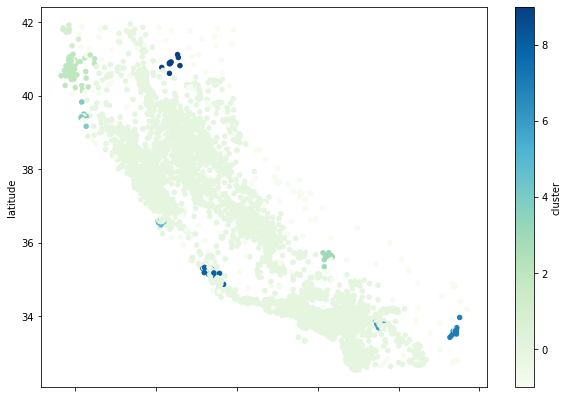

In [49]:
df_pd.plot(kind = 'scatter',x = 'longitude',y = 'latitude',c = 'cluster',cmap = 'GnBu', figsize=(10, 7))
plt.show()

**Conclusion: this option will not help us**

In [50]:
import osmnx as ox
ox.config(use_cache=True, log_console=True)

In [51]:
import h3
from shapely.geometry import Polygon

In [52]:
import geopandas as gpd
from shapely import wkt
import json
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [53]:
def visualize_polygons(geometry):
    
    lats, lons = get_lat_lon(geometry)
    
    m = folium.Map(location=[sum(lats)/len(lats), sum(lons)/len(lons)], zoom_start = 5)
    
    overlay = gpd.GeoSeries(geometry).to_json()
    folium.GeoJson(overlay, name = 'boundary').add_to(m)
    
    return m

def get_lat_lon(geometry):
        
    lon = geometry.apply(lambda x: x.x if x.type == 'Point' else x.centroid.x)
    lat = geometry.apply(lambda x: x.y if x.type == 'Point' else x.centroid.y)
    return lat, lon

In [54]:
%%time

area = 'US-CA'
obj = {'boundary':'administrative',  'admin_level':'4'}
polygon_usa = ox.geometries_from_place(area, obj,).reset_index()

CPU times: user 27min 33s, sys: 29.4 s, total: 28min 2s
Wall time: 28min 4s


In [55]:
polygon_usa_cut = polygon_usa[(polygon_usa['admin_level'] == '4') & (polygon_usa['name'] == 'California')]

In [56]:
visualize_polygons(polygon_usa_cut['geometry'])

**Generate hexagons inside a polygon:**

First, let's generate 1 trial hex:

In [57]:
def visualize_hexagons(hexagons, color="red", folium_map=None):

    polylines = []
    lat = []
    lng = []
    for hex in hexagons:
        polygons = h3.h3_set_to_multi_polygon([hex], geo_json=False)
        outlines = [loop for polygon in polygons for loop in polygon]
        polyline = [outline + [outline[0]] for outline in outlines][0]
        lat.extend(map(lambda v:v[0],polyline))
        lng.extend(map(lambda v:v[1],polyline))
        polylines.append(polyline)
    
    if folium_map is None:
        m = folium.Map(location=[sum(lat)/len(lat), sum(lng)/len(lng)], zoom_start=4, tiles='cartodbpositron')
    else:
        m = folium_map
        
    for polyline in polylines:
        my_PolyLine=folium.PolyLine(locations=polyline,weight=8,color=color)
        m.add_child(my_PolyLine)
    return m
  
h3_address = h3.geo_to_h3(33.049349, -118.675605,  1) 
visualize_hexagons([h3_address])

In [58]:
def create_hexagons(geoJson):
    
    lat, lng = get_lat_lon(polygon_usa_cut['geometry'])
    
    m = folium.Map(location = [sum(lat)/len(lat), sum(lng)/len(lng)], zoom_start = 5, tiles='cartodbpositron')
    
    overlay = gpd.GeoSeries(polygon_usa_cut['geometry'])
    folium.GeoJson(overlay, name = 'boundary').add_to(m)

    hexagons = list(h3.polyfill(geoJson, 4))  #<--scale
    polylines = []
    lat = []
    lng = []
    for hex in hexagons:
        polygons = h3.h3_set_to_multi_polygon([hex], geo_json=False)
        # flatten polygons into loops.
        outlines = [loop for polygon in polygons for loop in polygon]
        polyline = [outline + [outline[0]] for outline in outlines][0]
        lat.extend(map(lambda v:v[0],polyline))
        lng.extend(map(lambda v:v[1],polyline))
        polylines.append(polyline)
    for polyline in polylines:
        my_PolyLine=folium.PolyLine(locations=polyline,weight=3,color='red')
        m.add_child(my_PolyLine)
        
    polylines_x = []
    for j in range(len(polylines)):
        a = np.column_stack((np.array(polylines[j])[:,1],np.array(polylines[j])[:,0])).tolist()
        polylines_x.append([(a[i][0], a[i][1]) for i in range(len(a))])
        
    polygons_hex = pd.Series(polylines_x).apply(lambda x: Polygon(x))
        
    return m, polygons_hex, polylines

**Generate hexagons inside a polygon**

In [59]:
geoJson = json.loads(gpd.GeoSeries(polygon_usa_cut['geometry']).to_json())
geoJson = geoJson['features'][0]['geometry']

In [60]:
mylist = []

for i in geoJson['coordinates']:
    for j in i:
        for z in j:
            if z not in mylist:
                mylist.append(z)
mat = np.array(mylist)

In [61]:
geoJson = {'type':'Polygon','coordinates': [np.column_stack((np.array(mat)[:, 1],
                                                      np.array(mat)[:, 0])).tolist()]}

In [62]:
%%time

m, polygons, polylines = create_hexagons(geoJson)
m

CPU times: user 214 ms, sys: 3.03 ms, total: 217 ms
Wall time: 215 ms


Next, we must determine whether each property belongs to a hex.

Create a geoPandasDataFrame based on initial data

In [63]:
houses = gpd.GeoDataFrame(
    df_pd, geometry = gpd.points_from_xy(df_pd.longitude, df_pd.latitude))

In [64]:
houses.head(3)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,cluster,geometry
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,0,POINT (-122.23000 37.88000)
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,0,POINT (-122.22000 37.86000)
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,0,POINT (-122.24000 37.85000)


**Now we need to make a dataframe with data about polygons (by the way, the function returns an array of coordinates about them)**

In [65]:
gdf_2 = pd.DataFrame(polygons, columns = ['geometry'])
gdf_2['polylines'] = polylines
gdf_2['geometry'] = gdf_2['geometry'].astype(str)

geometry_uniq = pd.DataFrame(gdf_2['geometry'].drop_duplicates())
geometry_uniq['id'] = np.arange(len(geometry_uniq)).astype(str)

gdf_2 = gdf_2.merge(geometry_uniq, on = 'geometry')
gdf_2['geometry'] = gdf_2['geometry'].apply(wkt.loads)
gdf_2 = gpd.GeoDataFrame(gdf_2, geometry='geometry')

In [66]:
itog_table = gpd.sjoin(gdf_2, houses, how = 'left', op = 'intersects')
itog_table = itog_table.dropna()
itog_table.head()

,geometry,polylines,id,index_right,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,cluster
0,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15232.0,-117.21,33.02,26.0,3194.0,454.0,1032.0,406.0,10.1560,500001.0,0.0
0,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15261.0,-117.26,33.02,9.0,4632.0,759.0,1724.0,685.0,6.3712,369800.0,0.0
0,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15254.0,-117.27,33.02,13.0,5723.0,1242.0,2450.0,1140.0,4.7179,376700.0,0.0
0,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15263.0,-117.27,33.02,21.0,2144.0,340.0,928.0,344.0,5.7980,286100.0,0.0
0,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15230.0,-117.21,33.03,20.0,3370.0,433.0,1020.0,408.0,11.0911,500001.0,0.0


Now it's up to the little things:
- calculate the average cost for each hex ID
- add feature to original dataframe
- run everything again through the pipeline

In [67]:
itog_table.groupby('id', as_index = False).agg(median_hex =  ('median_house_value','median'),
                                            cnt_hous = ('id','count'))

,id,median_hex,cnt_hous
0,0,173750.0,950
1,10,71700.0,1
2,100,157600.0,161
3,101,84700.0,49
4,102,137500.0,1
...,...,...,...
191,94,55000.0,6
192,96,118350.0,84
193,97,155700.0,9
194,98,65400.0,1


In [68]:
med = itog_table.groupby('id', as_index = False).agg(median_hex =  ('median_house_value','median'))
df_pd_end = itog_table.merge(med, on = ['id'], how = 'left')
df_pd_end.head(3)

,geometry,polylines,id,index_right,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,cluster,median_hex
0,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15232.0,-117.21,33.02,26.0,3194.0,454.0,1032.0,406.0,10.1560,500001.0,0.0,173750.0
1,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15261.0,-117.26,33.02,9.0,4632.0,759.0,1724.0,685.0,6.3712,369800.0,0.0,173750.0
2,"POLYGON ((-117.01180 32.99503, -117.29437 33.0...","[(32.99503312235357, -117.0118042641416), (33....",0,15254.0,-117.27,33.02,13.0,5723.0,1242.0,2450.0,1140.0,4.7179,376700.0,0.0,173750.0


In [69]:
df_pd_end[['longitude','latitude','median_house_value','median_hex']].to_csv('clusters.csv', index = False)

In [70]:
hex_avg = spark.read.csv(PTH_CL, inferSchema = True, header = True)
hex_avg.printSchema() 

root
 |-- longitude: double (nullable = true)
 |-- latitude: double (nullable = true)
 |-- median_house_value: double (nullable = true)
 |-- median_hex: double (nullable = true)



In [71]:
df_pipe = spark.read.csv(PTH, inferSchema = True, header = True)
df_pipe.printSchema() 

root
 |-- longitude: double (nullable = true)
 |-- latitude: double (nullable = true)
 |-- housing_median_age: double (nullable = true)
 |-- total_rooms: double (nullable = true)
 |-- total_bedrooms: double (nullable = true)
 |-- population: double (nullable = true)
 |-- households: double (nullable = true)
 |-- median_income: double (nullable = true)
 |-- median_house_value: double (nullable = true)
 |-- ocean_proximity: string (nullable = true)



In [72]:
df_pipe.count()

20640

In [73]:
df_pipe = (df_pipe.join(hex_avg,(df_pipe.longitude == hex_avg.longitude) &
                        (df_pipe.latitude == hex_avg.latitude) & 
                        (df_pipe.median_house_value == hex_avg.median_house_value),'left')
          .select(df_pipe.longitude, df_pipe.latitude, df_pipe.housing_median_age, df_pipe.total_rooms, 
                 df_pipe.total_bedrooms, df_pipe.population,  df_pipe.households,  df_pipe.median_income,
                 df_pipe.median_house_value, df_pipe.ocean_proximity, hex_avg.median_hex
                )).distinct()

In [74]:
df_pipe.count()

20640

We designate lists of features by the type of variables:

In [75]:
categorical  = ['ocean_proximity']
target = 'median_house_value'
numerical = [x for x in df_housing.columns if x not in categorical and x not in target]

In [76]:
train_df, test_df = df_pipe.randomSplit([.8,.2], seed=RANDOM_SEED)
print(train_df.count(), test_df.count()) 

16565 4075


The general stages of the pipeline:

In [77]:
stages = []

### imputer
imputer = Imputer(inputCols  = numerical, 
                      outputCols = numerical
                          ).setStrategy("median")
stages += [imputer]

### assembler
numerical_assembler = VectorAssembler(inputCols = numerical, 
                             outputCol = "numerical_features")
stages += [numerical_assembler]

### scaler
standardScaler = StandardScaler(inputCol = "numerical_features", 
                            outputCol = "numerical_features_scaled")

stages += [standardScaler]

In [78]:
stages_1 = stages 

lr_nmb = LinearRegression(labelCol = target, featuresCol = 'numerical_features_scaled')

stages_1 += [lr_nmb]

In [79]:
stages_1

[Imputer_48fc818bed6c89d9393c,
 VectorAssembler_4af7b3f70953d0f8dc59,
 StandardScaler_4e65958217b19323c867,
 LinearRegression_401ab670035d1155e9a9]

In [80]:
pipeline_1 = Pipeline(stages = stages_1)

model_1 = pipeline_1.fit(train_df)

predictions_1 = model_1.transform(test_df)
predictedLabes_nmb = predictions_1.select("median_house_value", "prediction")

**Final result**

In [81]:
trainingSummary_nmb_pipe = model_1.stages[-1].summary

print("RMSE: %f" % trainingSummary_nmb_pipe.rootMeanSquaredError)
print("MAE: %f" % trainingSummary_nmb_pipe.meanAbsoluteError)
print("r2: %f" % trainingSummary_nmb_pipe.r2)

RMSE: 69435.145720
MAE: 50860.363105
r2: 0.633357


**Result without custom feature:**
  - RMSE: 69558.014937
  - MAE: 50859.016819
  - r2: 0.632061